# Experimentation
The point of this notebook is to experiment with some of the aspects of the code.  Namely, for today, I want to investigate the gravitational interactions between 2 masses orbiting their collective center-of-mass and see if I can plot their trajectories.  This notebook is kept on as an illustration of the development process.

Author: Jack Felice

Revision History:
- 2024-04-19: Initial version created and uploaded to repository
- 2024-04-20: Added this version/author string and added information to notebook metadata

### Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from Definitions import * # Importing the definitions from the Definitions.py file
import matplotlib
%matplotlib widget

import ffmpeg
from IPython.display import HTML
matplotlib.rcParams['animation.embed_limit'] = 2**128

Text(0, 0.5, 'Y position')

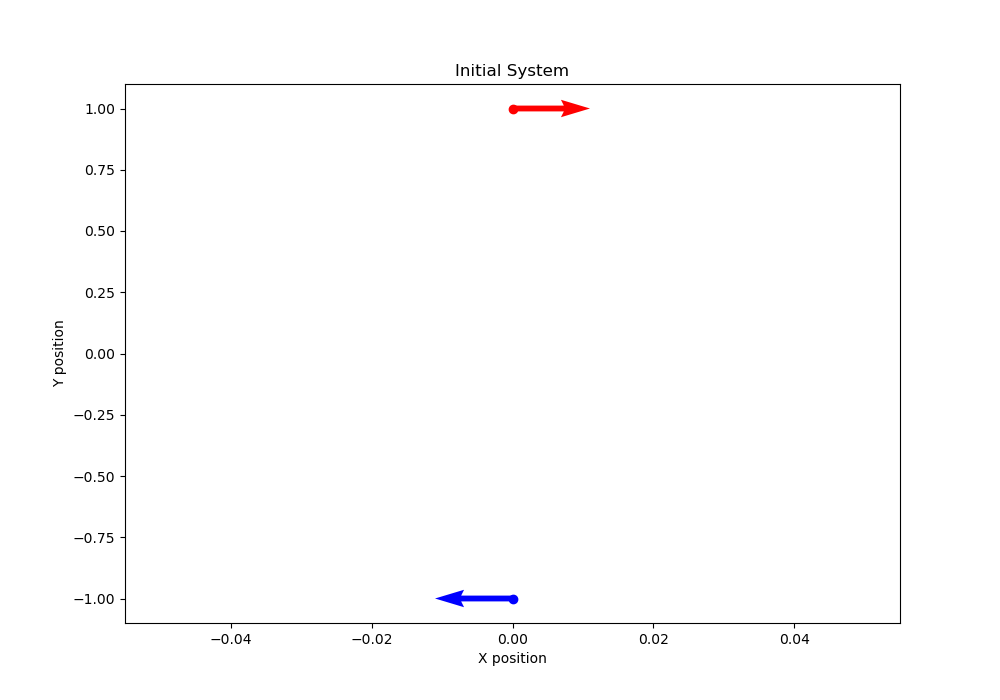

In [2]:
# Simplest scenario: two equal masses both travelling along a circular orbit around their center
# "Mass" objects created without accelerations assume no acceleration before calculation
mass1 = Mass(1, np.array([0., 1.]), np.array([0.5, 0.]))
mass2 = Mass(1, np.array([0., -1.]), np.array([-0.5, 0.]))

# Plot masses and their initial velocities
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(1, 1, 1)
ax.set_title("Initial System")
ax.plot(mass1.position[0], mass1.position[1], 'ro',label='Mass 1')
ax.plot(mass2.position[0], mass2.position[1], 'bo',label='Mass 2')
ax.quiver(mass1.position[0], mass1.position[1], mass1.velocity[0], mass1.velocity[1], color='r', label='Velocity 1', scale=5)
ax.quiver(mass2.position[0], mass2.position[1], mass2.velocity[0], mass2.velocity[1], color='b', label='Velocity 2', scale=5)
ax.set_xlabel('X position')
ax.set_ylabel('Y position')

In [3]:
mass2.force(mass1)

array([0.  , 0.25])

In [4]:
t_start = 0
t_end = 10
dt = 0.01

t = t_start

position1 = np.array([mass1.position])
position2 = np.array([mass2.position])
velocity1 = np.array([mass1.velocity])
velocity2 = np.array([mass2.velocity])

while (t < t_end):
    # Calculate the force on each mass
    force1 = np.array([0., 0.])
    force2 = np.array([0., 0.])
    force1 += mass1.force(mass2)
    force2 += mass2.force(mass1) # Mirrors how, for N-Body simulation, we will need to iterate through list of Mass objects

    # Update the position and velocity of each mass
    mass1.update(force1, dt)
    mass2.update(force2, dt)

    # Append the new positions and velocities to the arrays
    position1 = np.append(position1, np.array([mass1.position]), axis=0)
    position2 = np.append(position2, np.array([mass2.position]), axis=0)
    velocity1 = np.append(velocity1, np.array([mass1.velocity]), axis=0)
    velocity2 = np.append(velocity2, np.array([mass2.velocity]), axis=0)

    t += dt

In [5]:
position1[:, 0]

array([ 0.        ,  0.005     ,  0.00999987, ..., -0.9616634 ,
       -0.9602404 , -0.95879356])

Text(0, 0.5, 'Y position')

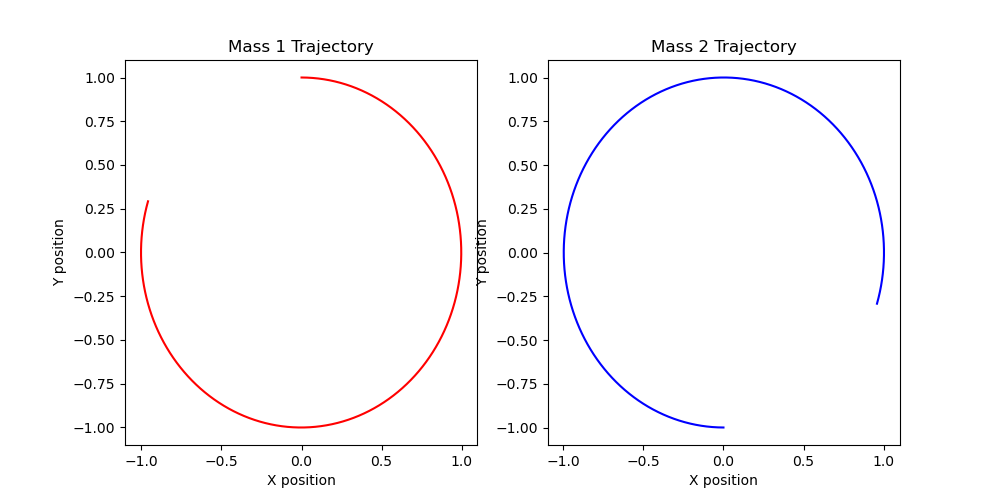

In [6]:
### Check work by plotting trajectories of mass 1 and mass 2
fig1 = plt.figure(figsize=(10, 5))
ax1 = fig1.add_subplot(1, 2, 1)
ax2 = fig1.add_subplot(1, 2, 2)
ax1.set_title("Mass 1 Trajectory")
ax2.set_title("Mass 2 Trajectory")
ax1.plot(position1[:,0], position1[:,1], 'r-')
ax2.plot(position2[:,0], position2[:,1], 'b-')
ax1.set_xlabel('X position')
ax1.set_ylabel('Y position')
ax2.set_xlabel('X position')
ax2.set_ylabel('Y position')


Great, looks like it worked!  This is pretty tedious, though-- there has to be a better way to vectorize for generalizing to N bodies.  Now, let's try to animate these trajectories:

In [7]:
%%capture
from matplotlib.animation import FuncAnimation

# Create a figure and axis for the animation
fig_anim = plt.figure(figsize=(10, 7))
ax_anim = fig_anim.add_subplot(1, 1, 1)
ax_anim.set_xlim(-1.5, 1.5)
ax_anim.set_ylim(-1.5, 1.5)
ax_anim.set_title("Trajectories Animation")
ax_anim.set_xlabel('X position')
ax_anim.set_ylabel('Y position')

# Initialize the line objects for the trajectories
line1, = ax_anim.plot([], [], 'r-', label='Mass 1')
line2, = ax_anim.plot([], [], 'b-', label='Mass 2')

# Animation update function
def update(frame):
    line1.set_data(position1[:frame, 0], position1[:frame, 1])
    line2.set_data(position2[:frame, 0], position2[:frame, 1])
    return line1, line2

# Create the animation
animation = FuncAnimation(fig_anim, update, frames=len(position1), interval=10, blit=True)

# Display the animation
fig_anim.legend()


In [8]:
# writer = matplotlib.animation.PillowWriter(fps=30,
#                                 metadata=dict(artist='Jack Felice'),
#                                 bitrate=1800)
# animation.save("TwoMasses.gif", writer=writer)

In [9]:
HTML(animation.to_jshtml())

In [10]:
animation.save('twoMasses.mp4', writer='ffmpeg')